# Nightly Look at Data

This notebook is a nightly look at the data. It is run and commited to <github> every night. Maybe even push it to a slack channel? Make sure to set the HERA_DATA_DIR environment variable to the directory that has the nightly data in it. 

In [1]:
import numpy as np, capo.omni as omni, sys,os, optparse, glob, capo, aipy as a, capo.zsa as zsa, capo.plot as plot
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as p
import seaborn as sns
sns.set_context('poster')
sns.set_style('darkgrid') 
p.rcParams['figure.figsize'] = 12, 8


colors = ["#006BA4", "#FF7F0E", "#2CA02C", "#D61D28", "#9467BD", "#8C564B", "#E377C2", "#7F7F7F", "#BCBD22", "#17BECF"]
symbols = ["o", "v", "^", "<", ">", "*"]
pols = ['xx','yy']

#Get list of redundant antennas to look at
aa = a.cal.get_aa('hsa7458_v000', np.array([.150]))
info = omni.aa_to_info(aa, fcal=True) 
antstrs = []
for k in info.get_reds(): antstrs.append(capo.zsa.list2str(k))

Loading FirstCalRedundantInfo class


In [27]:
%%bash
#running firstcal
for f in ${HERA_DATA_DIR}/zen.*.*.xx.HH.uvc; do ${FIRSTCAL_SCRIPT} -C hsa7458_v000 --ex_ants=${EX_ANTS_X} ${f} > /dev/null; done 
for f in ${HERA_DATA_DIR}/zen.*.*.yy.HH.uvc; do ${FIRSTCAL_SCRIPT} -C hsa7458_v000 --ex_ants=${EX_ANTS_Y} ${f} > /dev/null; done


SyntaxError: invalid syntax (<ipython-input-27-b66706934638>, line 2)

# Applying Firstcal delays to Visibilites
### Baselines in each redundant group.
     '31_97,53_112,64_72,96_10,80_22,104_81',
     '72_80,97_96,112_104',
     '88_97,80_43,64_10',
     '22_112,81_97,9_22,20_81,31_89,88_105,104_31,80_53,96_65,105_72,64_9,89_10,53_20,65_43',
     '10_88,43_64',
     '31_72,65_112,104_105,96_22',
     '10_20,20_64,22_88,31_80,65_104,81_9,43_31,89_53,97_22,112_105',
     '43_104,10_53,81_64,97_9,89_80,112_88',
     '9_65,22_43,64_96,88_31,105_89,72_10',
     '65_105,43_72,96_88',
     '10_104,97_53,112_64,81_80',
     '43_53,81_88,65_80,97_105,10_9,89_64',
     '9_31,20_65,22_89,53_96,64_104,72_81,105_20,81_43,88_53,112_10',
     '10_105,43_9,65_64,89_88',
     '31_81,64_105,9_72,20_112,89_97,80_9,104_20,96_89,65_10,53_22',
     '9_88,10_81,22_105,31_53,43_89,53_64,96_104,97_112,20_9,89_20,81_22,65_31,112_72,104_80',
     '22_104,81_96,112_31,72_53,97_65,105_80',
     '96_112,104_72',
     '9_105,20_22,64_88,65_89,10_97,22_72,81_112,96_31,104_53,80_64,53_9,43_10,31_20,89_81',
     '53_105,65_81,20_72,43_97,80_88,89_112,104_9,96_20,31_22',
     '9_112,20_97,53_81,80_20,96_43,88_72,104_89,31_10,64_22',
     '10_80,97_64',
     '10_22,20_88,31_64,81_105,89_9,43_20,65_53,97_72,96_80',
     '80_112,104_97',
     '31_105,43_112,96_9,89_72,104_88,65_22',
     '65_72,96_105',
     '43_105,65_88'

## Firstcal delay solutions

In [4]:
def load_dmv(filestring, offsets=False, verbose=False):
    files = glob.glob(filestring)
    delays = {}
    means = {}
    medians = {}
    vars = {}
    if offsets: ss = 'o'
    else: ss = 'd'
    for f in files:
        if verbose:
            print 'Reading %s'%f    
        npz = np.load(f)
        for key in npz.files:
            if key.startswith(ss):
                if key not in delays.keys(): 
                    delays[key] = npz[key]
                    continue 
                delays[key] = np.hstack((delays[key],npz[key]))
    
    for k in delays.keys():
        delays[k] = np.array(delays[k]).flatten()
        means[k] = np.mean(delays[k])
        medians[k] = np.median(delays[k])
        vars[k] = np.var(delays[k])
        
    return delays,means,medians,vars
    

delays = {}
means = {}
medians = {}
vars = {}
for pol in pols:
    delays[pol], means[pol], medians[pol], vars[pol] = load_dmv('{0}/zen.*.{1}.HH.uvc.fc.npz'.format(data_dir,pol),offsets=False)

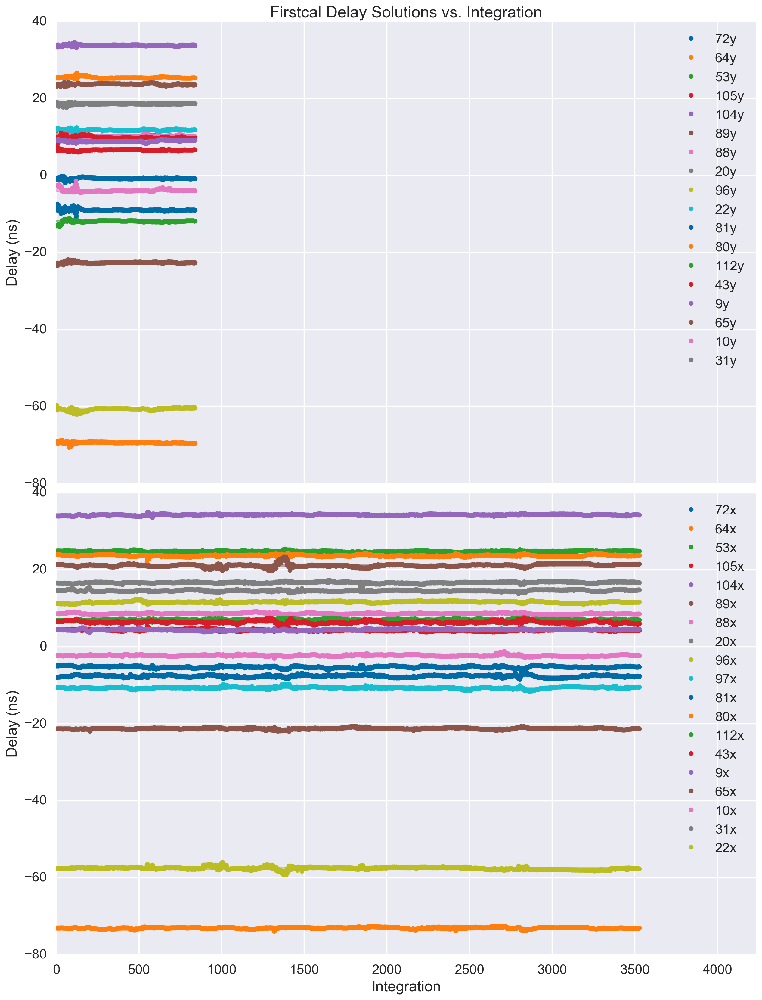

In [5]:
fig = p.figure(figsize=(15,20))


axes=[]
for ip,pol in enumerate(delays.keys()):
    if len(axes)!=0: axes.append(p.subplot(2,1,1+ip, sharex=axes[0]))
    else: axes.append(p.subplot(2,1,1+ip))
    for i,k in enumerate(delays[pol].keys()): 
        p.plot(delays[pol][k],'.', color=colors[i%10], label=k[1:]+pol[0])
        p.fill_between(np.arange(delays[pol][k].size), means[pol][k] - vars[pol][k]**.5, means[pol][k] + vars[pol][k]**.5, alpha=.5, color=colors[i%10])
    p.xlim(0,delays[pol][k].size + delays[pol][k].size*.2)   
    p.ylabel('Delay (ns)')
    p.legend()
p.setp(axes[0].get_xticklabels(), visible=False)
p.subplots_adjust(hspace=.02)    
p.xlabel('Integration') 

axes[0].set_title('Firstcal Delay Solutions vs. Integration')

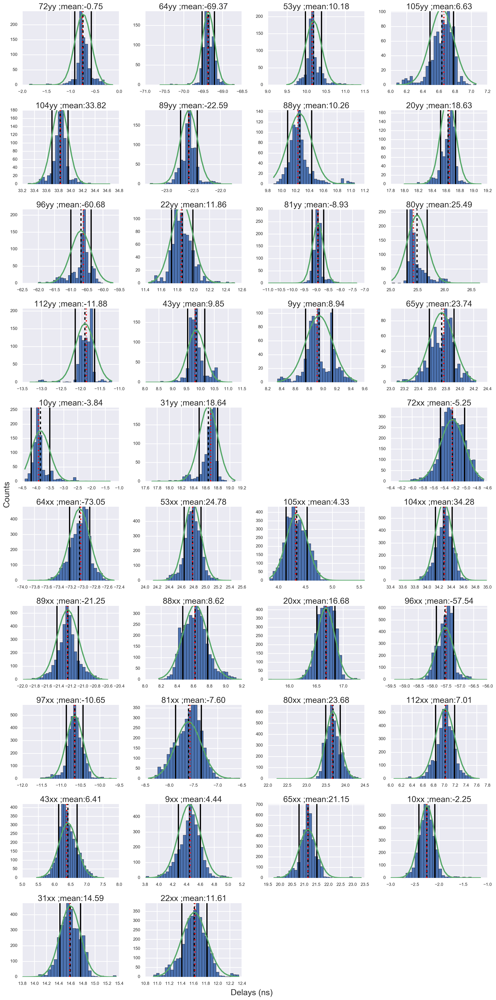

In [6]:
#df = pd.DataFrame(delays)
def gaussian(x,mu,std,scale):
    return scale/np.sqrt(np.pi*2*std) * np.exp(-.5*(x-mu)**2/(std**2))
    
nants = len(delays[pol].keys())*len(pols)
nc = 4
nr = int(divmod(nants,nc)[0] + np.ceil(divmod(nants,nc)[1]/float(nc)))
fig = p.figure(figsize=(16,32))

for ip, pol in enumerate(delays.keys()):
    for i,k in enumerate(delays[pol].keys()):
        p.subplot(nr,nc,i+1 + ip*len(delays[pol].keys()))
        h = p.hist(delays[pol][k], bins=30)
        p.tick_params(labelsize=10)
        p.title(k[1:]+pol + ' ;mean:%1.2f'%means[pol][k])
        p.grid(1)
        mx = np.max(h[0])
        p.plot(h[1],gaussian(h[1],means[pol][k],vars[pol][k]**.5,scale=mx))
        p.vlines(means[pol][k], 0, mx, linestyle='--')
        p.vlines(medians[pol][k],0,mx, linestyle='-.', color='red')
        p.vlines(means[pol][k]-np.sqrt(vars[pol][k]),0,mx)
        p.vlines(means[pol][k]+np.sqrt(vars[pol][k]),0,mx)
        p.ylim(0,mx)
#        if divmod(i,nc)[-1] == 0:  p.ylabel('Counts')
#        if divmod(i,nc)[0] == nr-1:  p.xlabel('Delay (ns)')
p.tight_layout(pad=1.0)
fig.text(.01, .5, 'Counts', ha='center', va='center',rotation='vertical')
fig.text(.5, .001, 'Delays (ns)', ha='center', va='center')
#p.subplots_adjust(wspace=.5,hspace=.6)
    

# Rewriting solutions

We could apply the solutions on a time by time basis, but since the solutions are pretty stable versus time with only a ~nanosecond variation over the whole day on each antenna, it is reasonable to just take the mean or the median. As seen from above, the mean and the median are pretty close for all the antennas and so we opt to use the median soltuion. Using one number for the entire day is going to minimizing introducing time dependent structure into the calibrated visibilities. Lets see how we fare... 

First we need to write out new gain solutions and apply them.



In [74]:
%%bash 
#make 
for pol in xx yy; do write_median_firstcal_files.py ${HERA_DATA_DIR}/zen.*.${pol}.HH.uvc.fc.npz; done

#apply solutions 
!cd ${HERA_DATA_DIR}; for pol in xx yy; do ~/src/capo/omni/omni_apply.py  -p $pol --omnipath="%s.HH.uvc.median.fc.npz" zen.*${pol}.HH.uvc --firstcal

xx
yy


bash: line 1: write_median_firstcal_files.py: command not found
bash: line 1: write_median_firstcal_files.py: command not found


In [7]:
antstr = '9_88,10_81,22_105,31_53,43_89,53_64,96_104,97_112,20_9,89_20,81_22,65_31,112_72,104_80'
_, pdata, _ = capo.miriad.read_files(glob.glob('{0}/zen.*.*.HH.uvc'.format(os.environ['HERA_DATA_DIR'])), antstr, ','.join(pols))
_, fdata, _ = capo.miriad.read_files(glob.glob('{0}/zen.*.*.HH.uvcF'.format(os.environ['HERA_DATA_DIR'])), antstr, ','.join(pols))
#Conjugates data correctly so all baselines are pointing in the same direction.
pdata = zsa.order_data(pdata,info)
fdata = zsa.order_data(fdata,info)

In [8]:
nbls = len(pdata.keys())

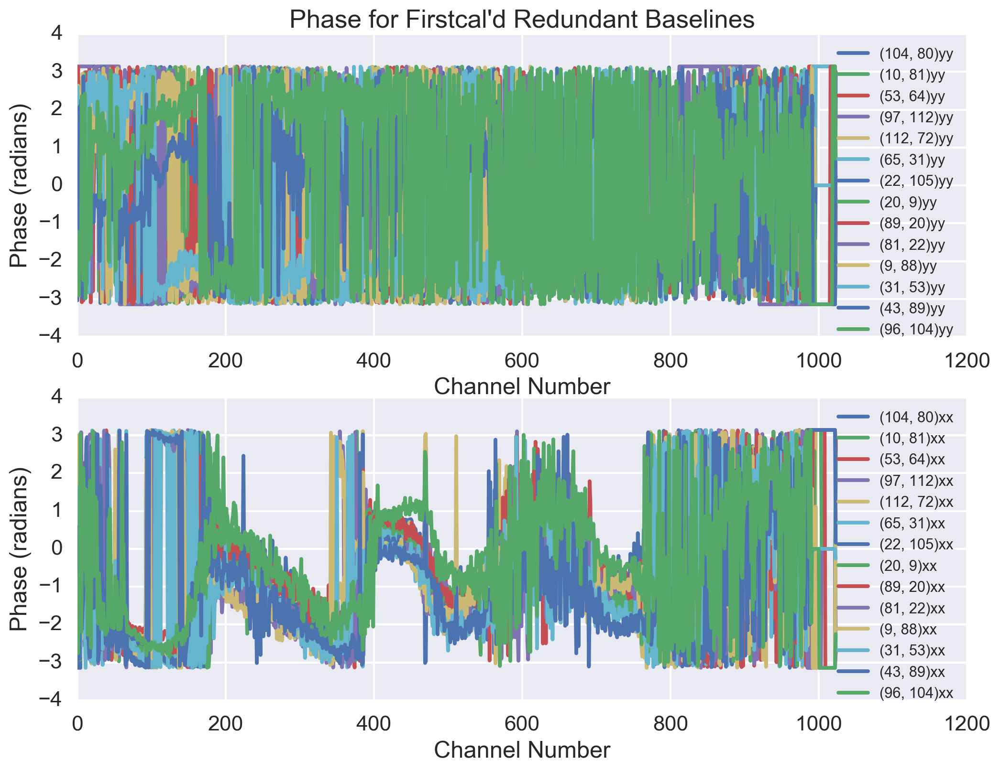

In [9]:
p.figure(figsize=(12,9))
integration_number = 12
for i,k in enumerate(fdata.keys()):
    for ip,pol in enumerate(fdata[k].keys()):
        p.subplot(211+ip)
        p.plot(np.angle(fdata[k][pol][integration_number]), label=str(k)+pol)
        p.ylabel('Phase (radians)')
        p.xlabel('Channel Number')
for i in range(len(pols)):
    p.subplot(211+i)
    p.legend(fontsize='xx-small')
p.subplot(211); p.title('Phase for Firstcal\'d Redundant Baselines')


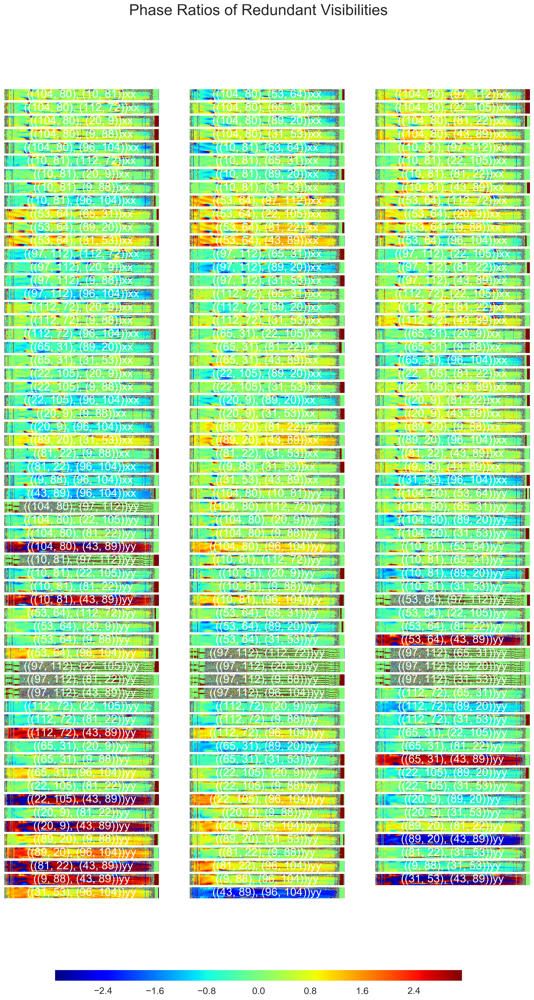

In [13]:
nratios = (nbls * (nbls-1))/2
nc = 3
div,mod = divmod(nratios,nc)
nr = int(div + np.ceil(mod/3.)) * len(pols)

crosses = []
bls = pdata.keys()
for k in range(nbls): 
    for i in range(k+1,nbls): 
        crosses.append((bls[k],bls[i]))
ncross = len(crosses)

fig = p.figure(figsize=(16,25))
for ip,pol in enumerate(pols):
    for i,k in enumerate(crosses):
        ax = p.subplot(nr,nc,i+1+ncross*ip)
        g = 1.0
        capo.plot.waterfall(fdata[k[0]][pol]*np.conj(fdata[k[-1]][pol])*g, mode='phs', cmap='jet', mx=np.pi, drng=2*np.pi)    
        p.grid(0)
#        if divmod(i,nc)[-1] != 0:  ax.yaxis.set_visible(False) 
#        if divmod(i,nc)[0] != nr-1: ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        ax.xaxis.set_visible(False)
        xp, yp = np.average(ax.get_xlim()), np.average(ax.get_ylim())
        ax.text(xp,yp,str(k)+pol,color='white',ha='center', va='center')
        
p.xlabel('Channel Number')
p.ylabel('Integration')
p.suptitle('Phase Ratios of Redundant Visibilities', fontsize=26)

cax = fig.add_axes([0.2, 0.06, 0.6, 0.01])
p.colorbar(cax=cax, orientation='horizontal')

## Looking at omnical'd data

Now we run omnical on the data using the firstcal solutions as an initial guess of the solutions. Below are the commands for running omnical. 

In [ ]:
%%bash
#do a look for each polariztion
cd ${HERA_DATA_DIR}; ~/src/capo/omni/omni_run.py  -p xx --omnipath="%s.HH.uvc.median.fc.npz" zen.*xx.HH.uvc --firstcal
cd ${HERA_DATA_DIR}; ~/src/capo/omni/omni_run.py  -p yy --omnipath="%s.HH.uvc.median.fc.npz" zen.*yy.HH.uvc --firstcal
cd ${HERA_DATA_DIR}; ~/src/capo/omni/omni_apply.py -p xx --omnipath="%s.npz" zen.*xx.HH.uvc 
cd ${HERA_DATA_DIR}; ~/src/capo/omni/omni_apply.py -p yy --omnipath="%s.npz" zen.*yy.HH.uvc 

In [16]:
_, data, _ = capo.miriad.read_files(glob.glob('{0}/zen.*.*.HH.uvcO'.format(os.environ['HERA_DATA_DIR'])), antstr, ','.join(pols))
data = zsa.order_data(data,info)

KeyError: 'yy'

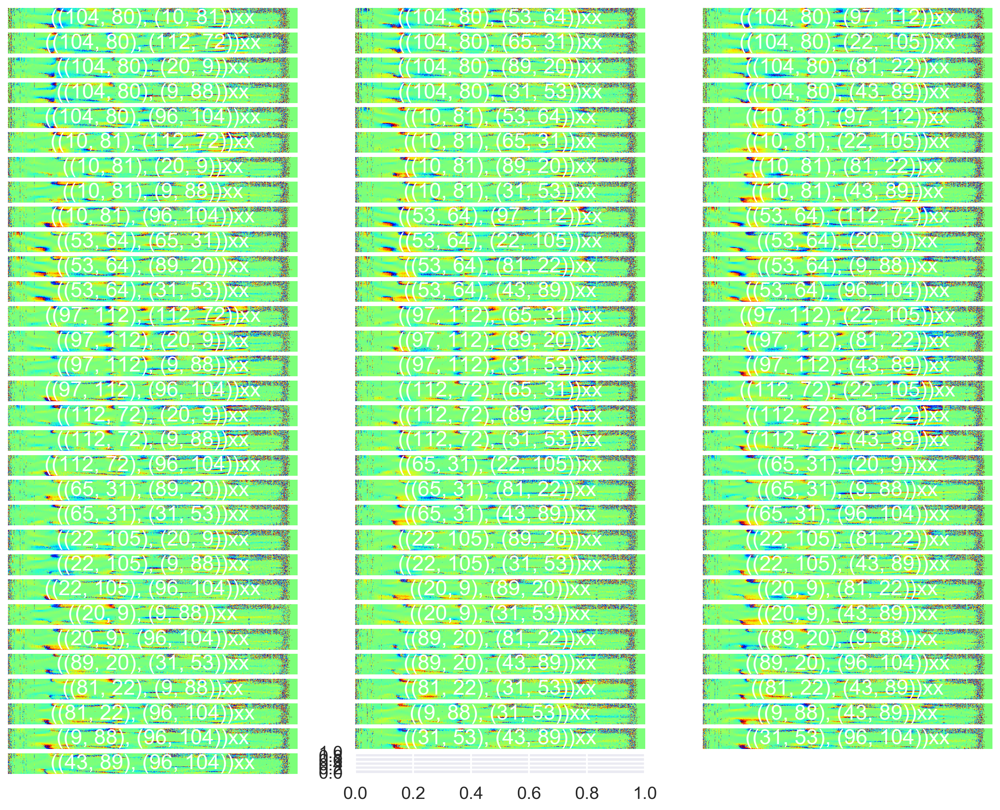

In [17]:
nratios = (nbls * (nbls-1))/2
nc = 3
div,mod = divmod(nratios,nc)
nr = int(div + np.ceil(mod/3.)) * len(pols)

crosses = []
bls = pdata.keys()
for k in range(nbls): 
    for i in range(k+1,nbls): 
        crosses.append((bls[k],bls[i]))
ncross = len(crosses)

fig = p.figure(figsize=(16,25))
for ip,pol in enumerate(pols):
    for i,k in enumerate(crosses):
        ax = p.subplot(nr,nc,i+1+ncross*ip)
        g = 1.0
        capo.plot.waterfall(data[k[0]][pol]*np.conj(data[k[-1]][pol])*g, mode='phs', cmap='jet', mx=np.pi, drng=2*np.pi)    
        p.grid(0)
#        if divmod(i,nc)[-1] != 0:  ax.yaxis.set_visible(False) 
#        if divmod(i,nc)[0] != nr-1: ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        ax.xaxis.set_visible(False)
        xp, yp = np.average(ax.get_xlim()), np.average(ax.get_ylim())
        ax.text(xp,yp,str(k)+pol,color='white',ha='center', va='center')
        
p.xlabel('Channel Number')
p.ylabel('Integration')
p.suptitle('Phase Ratios of Redundant Visibilities', fontsize=26)

cax = fig.add_axes([0.2, 0.06, 0.6, 0.01])
p.colorbar(cax=cax, orientation='horizontal')

In [16]:
_, view_data, _ = capo.miriad.read_files(glob.glob('{0}/zen.*.5*.HH.uvc'.format(os.environ['HERA_DATA_DIR']))[:2], 'cross', ','.join(pols) ,verbose=False)
_, view_data_fcal, _ = capo.miriad.read_files(glob.glob('{0}/zen.*.*.HH.uvcF'.format(os.environ['HERA_DATA_DIR']))[:2], 'cross', ','.join(pols) ,verbose=False)
_, view_data_ocal, _ = capo.miriad.read_files(glob.glob('{0}/zen.*.*.HH.uvcO'.format(os.environ['HERA_DATA_DIR']))[:2], 'cross', ','.join(pols) ,verbose=False)
view_data = zsa.order_data(view_data,info)
view_data_fcal = zsa.order_data(view_data_fcal,info)
view_data_ocal = zsa.order_data(view_data_ocal,info)

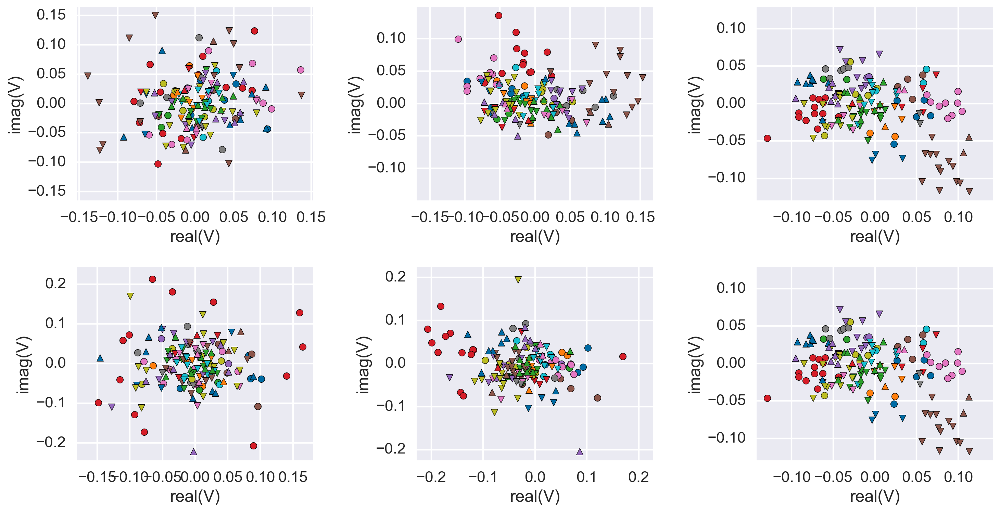

In [24]:
fig = p.figure(figsize=(15,8))
for ip,pol in enumerate(pols):
    p.subplot(231 + 3*ip)
    plot.omni_view(info.get_reds(), view_data, pol, int=10, chan=425, cursor=False, ex_ants=[97])
    if ip == 0: 
    p.subplot(232 + 3*ip)
    plot.omni_view(info.get_reds(), view_data_fcal, pol, int=10, chan=425, cursor=False, ex_ants=[97])
    p.subplot(233 + 3*ip)
    if pol =='yy': pol='xx'
    plot.omni_view(info.get_reds(), view_data_ocal, pol, int=10, chan=425, cursor=False, ex_ants=[97])
p.tight_layout()
p.suptitle('Omniview')

## Omnical Solutions

In [26]:
# (mx,gx,vx,xx) = omni.from_npz(glob.glob('{0}/zen.*.xx.npz'.format(os.environ['HERA_DATA_DIR'])))
# (my,gy,vy,xy) = omni.from_npz(glob.glob('{0}/zen.*.yy.npz'.format(os.environ['HERA_DATA_DIR'])))
# m,g,v,x = zip((mx,gx,vx,xx),(my,gy,vy,xy))

In [ ]:
# nants = 19
# r = 5
# c = 4
# print r, c
# fig = p.figure(figsize=(16,12))

# i = 0
# for mm in m:
#     for k in m.keys():
#         if k.startswith('c') and k.endswith('x'):
#             ax = p.subplot(r,c,i+1)
#             p.title(k)
#             p.grid(0)
#             capo.plot.waterfall(m[k], mx =0, drng = 5, cmap='jet')
#             if divmod(i,c)[-1] != 0:  ax.yaxis.set_visible(False) 
#             if divmod(i,c)[0] != r-1: ax.xaxis.set_visible(False)
#             i+=1
# cax = fig.add_axes([0.2, 0.06, 0.6, 0.01])
# p.colorbar(cax=cax, orientation='horizontal')

In [ ]:
# p.figure(figsize=(12,10))
# for ant in g['x'].keys():
#     p.subplot(211)
#     p.plot(np.log10(np.abs(g['x'][ant][10])),label=str(ant))
#     p.title('Omnical Gains (single integration)')
#     p.ylabel('Log Amplitude')
#     p.subplot(212)
#     p.title('Omnical Gains in Phase(single integration)')
#     p.xlabel('Channel Number')
#     p.ylabel('Phase (radians)')
#     p.plot(np.angle(g['x'][ant][10]),label=str(ant))

In [ ]:
# #pick some random baselines
# bls = []
# for k in info.get_reds():
#     bls+=k
# bls = np.array(bls)
# plot_these = bls[np.random.randint(0,len(bls),5)]

# #get the mappings of visibilities to the stored mdl-visibilities in the 
# redmapping = {}
# for k in v['xx'].keys():
#     for gp in info.get_reds():
#         if k in gp:
#             for kk in gp : redmapping[kk] = k
# #get the baselines in string format.                
# s = ''
# for k in plot_these:
#     s += str(k[0])+'_'+str(k[1])+','
# s = s[:-1]